In [1]:
import numpy as np
import pandas as pd
import datetime
from time import strftime
import matplotlib.pyplot as plt
%matplotlib inline

import seaborn as sns

In [2]:
df=pd.read_csv("C:/Users/SAMHITA/OneDrive/Desktop/HEalthcare/EDAforHealthcare-main/Data.csv")

In [3]:
pd.set_option('display.max_rows',None)

In [4]:
pd.set_option('display.max_columns',None)

In [5]:
df.head()

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
0,2.987250e+13,5642903,F,2016-04-29T18:38:08Z,2016-04-29T00:00:00Z,62,JARDIM DA PENHA,0,1,0,0,0,0,No
1,5.589978e+14,5642503,M,2016-04-29T16:08:27Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,0,0,0,0,0,No
2,4.262962e+12,5642549,F,2016-04-29T16:19:04Z,2016-04-29T00:00:00Z,62,MATA DA PRAIA,0,0,0,0,0,0,No
3,8.679512e+11,5642828,F,2016-04-29T17:29:31Z,2016-04-29T00:00:00Z,8,PONTAL DE CAMBURI,0,0,0,0,0,0,No
4,8.841186e+12,5642494,F,2016-04-29T16:07:23Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,1,1,0,0,0,No


In [6]:
df.shape

(110527, 14)

In [7]:
df.info() 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 110527 entries, 0 to 110526
Data columns (total 14 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   PatientId       110527 non-null  float64
 1   AppointmentID   110527 non-null  int64  
 2   Gender          110527 non-null  object 
 3   ScheduledDay    110527 non-null  object 
 4   AppointmentDay  110527 non-null  object 
 5   Age             110527 non-null  int64  
 6   Neighbourhood   110527 non-null  object 
 7   Scholarship     110527 non-null  int64  
 8   Hipertension    110527 non-null  int64  
 9   Diabetes        110527 non-null  int64  
 10  Alcoholism      110527 non-null  int64  
 11  Handcap         110527 non-null  int64  
 12  SMS_received    110527 non-null  int64  
 13  No-show         110527 non-null  object 
dtypes: float64(1), int64(8), object(5)
memory usage: 11.8+ MB


In [8]:
## no missing values found

In [9]:
##  analysing the auto-increment features are not needed so, dropping these columns

df.drop(['PatientId','AppointmentID','Neighbourhood'],axis=1,inplace=True)

In [10]:
df.head()

,Gender,ScheduledDay,AppointmentDay,Age,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
0,F,2016-04-29T18:38:08Z,2016-04-29T00:00:00Z,62,0,1,0,0,0,0,No
1,M,2016-04-29T16:08:27Z,2016-04-29T00:00:00Z,56,0,0,0,0,0,0,No
2,F,2016-04-29T16:19:04Z,2016-04-29T00:00:00Z,62,0,0,0,0,0,0,No
3,F,2016-04-29T17:29:31Z,2016-04-29T00:00:00Z,8,0,0,0,0,0,0,No
4,F,2016-04-29T16:07:23Z,2016-04-29T00:00:00Z,56,0,1,1,0,0,0,No


In [11]:
## extracting the DD-MM-YYYY from ScheduledDay feature , also modifying it into standard date and time format

df['ScheduledDay']=pd.to_datetime(df['ScheduledDay']).dt.date.astype('datetime64[ns]')

df['AppointmentDay']=pd.to_datetime(df['AppointmentDay']).dt.date.astype('datetime64[ns]')

In [12]:
df.isna().sum()

Gender            0
ScheduledDay      0
AppointmentDay    0
Age               0
Scholarship       0
Hipertension      0
Diabetes          0
Alcoholism        0
Handcap           0
SMS_received      0
No-show           0
dtype: int64

In [13]:
df.head()

,Gender,ScheduledDay,AppointmentDay,Age,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
0,F,2016-04-29,2016-04-29,62,0,1,0,0,0,0,No
1,M,2016-04-29,2016-04-29,56,0,0,0,0,0,0,No
2,F,2016-04-29,2016-04-29,62,0,0,0,0,0,0,No
3,F,2016-04-29,2016-04-29,8,0,0,0,0,0,0,No
4,F,2016-04-29,2016-04-29,56,0,1,1,0,0,0,No


In [14]:
df['AppointmentDay'].dtypes

dtype('<M8[ns]')

In [15]:
df['ScheduledDay'].dtypes

dtype('<M8[ns]')

In [16]:
df.dtypes

Gender                    object
ScheduledDay      datetime64[ns]
AppointmentDay    datetime64[ns]
Age                        int64
Scholarship                int64
Hipertension               int64
Diabetes                   int64
Alcoholism                 int64
Handcap                    int64
SMS_received               int64
No-show                   object
dtype: object

In [17]:
## now we can see that the dtype has changed of scheduleday,appointmentday

In [18]:
## for the features appointmentday,scheduledday the particular day can be known , lets create columns

In [19]:
df['sch_weekday']=df['ScheduledDay'].dt.dayofweek  ## using dayofweek pandas function by passing the date it returns the day of the week 

## where Monday=0 , sunday=6

In [20]:
df['appntmnt_weekday']=df['AppointmentDay'].dt.dayofweek

In [21]:
df['sch_weekday'].value_counts()

sch_weekday
1    26168
2    24262
0    23085
4    18915
3    18073
5       24
Name: count, dtype: int64

In [22]:
## highest scheduled days were on tuesday ; it refers to many patients requested for an appointment on "tuesdays" 

In [23]:
df['appntmnt_weekday'].value_counts()

appntmnt_weekday
2    25867
1    25640
0    22715
4    19019
3    17247
5       39
Name: count, dtype: int64

In [24]:
## highest appointmentdays were on wednesday ; it refers that the appointment was scheduled by the healthcare provider on "Wednesdays"

In [25]:
## in weekends i.e., Thursday,Friday the patients didnt request for the schedules comparatively on weekdays

In [26]:
## in weekends i.e., Saturday only few patients were given appointment

In [27]:
df.dtypes

Gender                      object
ScheduledDay        datetime64[ns]
AppointmentDay      datetime64[ns]
Age                          int64
Scholarship                  int64
Hipertension                 int64
Diabetes                     int64
Alcoholism                   int64
Handcap                      int64
SMS_received                 int64
No-show                     object
sch_weekday                  int32
appntmnt_weekday             int32
dtype: object

In [28]:
import matplotlib.dates as mdates

In [29]:
v1=df['ScheduledDay']
v2=df['AppointmentDay']

In [30]:
dates_plt1=mdates.date2num(v1)


In [31]:
dates_plt2=mdates.date2num(v2)

C:\Users\SAMHITA\AppData\Local\Temp\ipykernel_10744\3824938495.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df['appntmnt_weekday'])


<AxesSubplot:xlabel='appntmnt_weekday', ylabel='Density'>

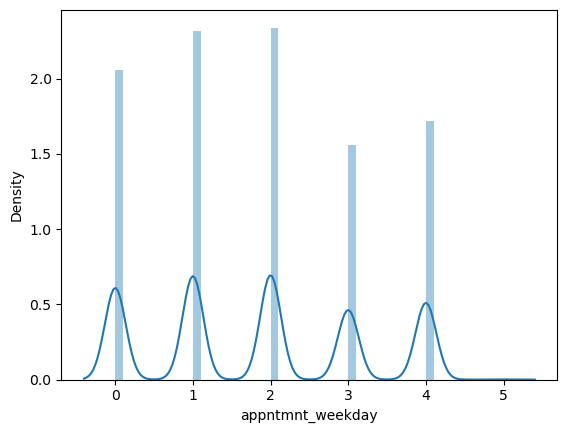

In [32]:
sns.distplot(df['appntmnt_weekday'])

In [33]:
## discrete numeric

C:\Users\SAMHITA\AppData\Local\Temp\ipykernel_10744\2332399528.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df['sch_weekday'])


<AxesSubplot:xlabel='sch_weekday', ylabel='Density'>

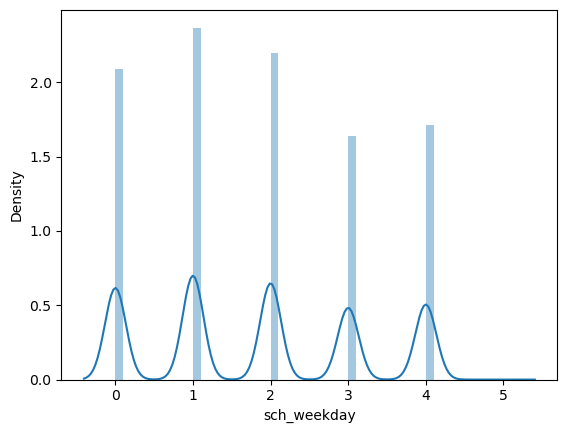

In [34]:
sns.distplot(df['sch_weekday'])

In [35]:
## discrete numeric

C:\Users\SAMHITA\AppData\Local\Temp\ipykernel_10744\3255828239.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df['Age'])


<AxesSubplot:xlabel='Age', ylabel='Density'>

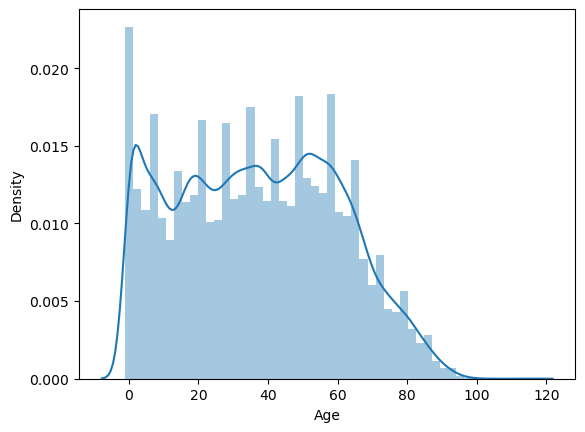

In [36]:
sns.distplot(df['Age'])

In [37]:
## continuous 

C:\Users\SAMHITA\AppData\Local\Temp\ipykernel_10744\119498613.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df['Scholarship'])


<AxesSubplot:xlabel='Scholarship', ylabel='Density'>

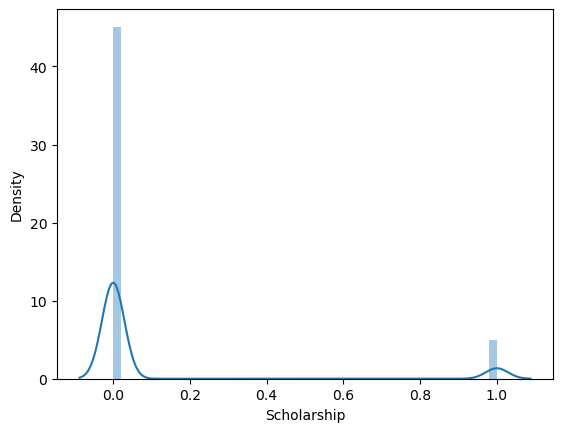

In [38]:
sns.distplot(df['Scholarship'])

In [39]:
## discrete numeric

In [40]:
df.columns

Index(['Gender', 'ScheduledDay', 'AppointmentDay', 'Age', 'Scholarship',
       'Hipertension', 'Diabetes', 'Alcoholism', 'Handcap', 'SMS_received',
       'No-show', 'sch_weekday', 'appntmnt_weekday'],
      dtype='object')

In [41]:
## Renaming the columns

df=df.rename(columns={'Hipertension':'Hypertension','Handcap':'Handicap','No-show':'NoShow'})

C:\Users\SAMHITA\AppData\Local\Temp\ipykernel_10744\3433882195.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df['Diabetes'])


<AxesSubplot:xlabel='Diabetes', ylabel='Density'>

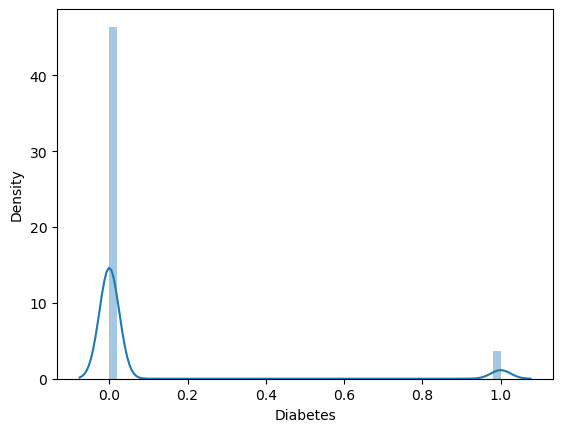

In [42]:
sns.distplot(df['Diabetes'])

In [43]:
## discrete numeric

C:\Users\SAMHITA\AppData\Local\Temp\ipykernel_10744\3363467185.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df['Hypertension'])


<AxesSubplot:xlabel='Hypertension', ylabel='Density'>

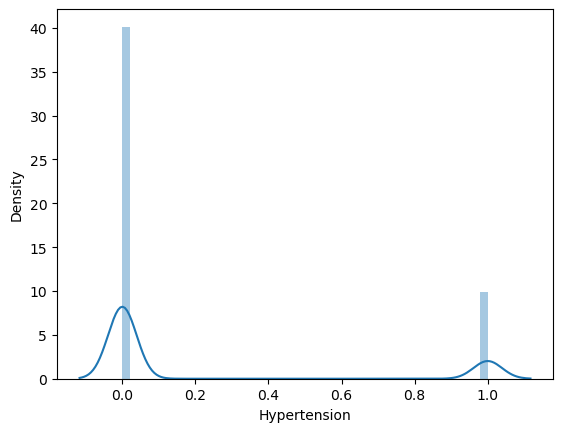

In [44]:
sns.distplot(df['Hypertension'])

In [45]:
### discrete numeric

C:\Users\SAMHITA\AppData\Local\Temp\ipykernel_10744\430627593.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df['Alcoholism'])


<AxesSubplot:xlabel='Alcoholism', ylabel='Density'>

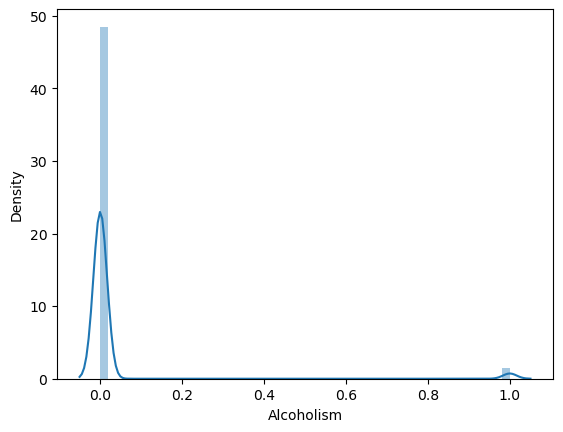

In [46]:
sns.distplot(df['Alcoholism'])

In [47]:
## discrete numeric

C:\Users\SAMHITA\AppData\Local\Temp\ipykernel_10744\681544068.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df['Handicap'])


<AxesSubplot:xlabel='Handicap', ylabel='Density'>

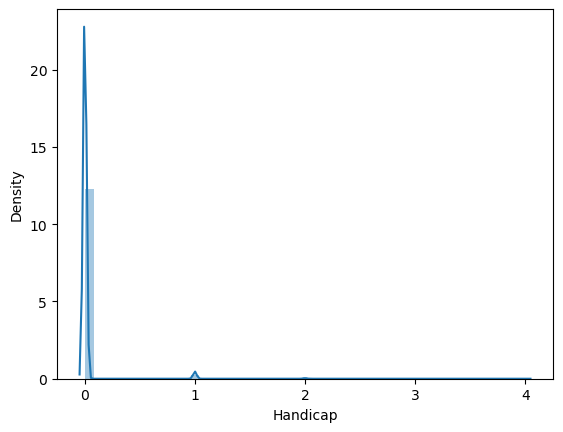

In [48]:
sns.distplot(df['Handicap'])

In [49]:
## discrete numeric

In [50]:
df.isna().sum()

Gender              0
ScheduledDay        0
AppointmentDay      0
Age                 0
Scholarship         0
Hypertension        0
Diabetes            0
Alcoholism          0
Handicap            0
SMS_received        0
NoShow              0
sch_weekday         0
appntmnt_weekday    0
dtype: int64

In [51]:
df.dtypes

Gender                      object
ScheduledDay        datetime64[ns]
AppointmentDay      datetime64[ns]
Age                          int64
Scholarship                  int64
Hypertension                 int64
Diabetes                     int64
Alcoholism                   int64
Handicap                     int64
SMS_received                 int64
NoShow                      object
sch_weekday                  int32
appntmnt_weekday             int32
dtype: object

<AxesSubplot:xlabel='NoShow', ylabel='Diabetes'>

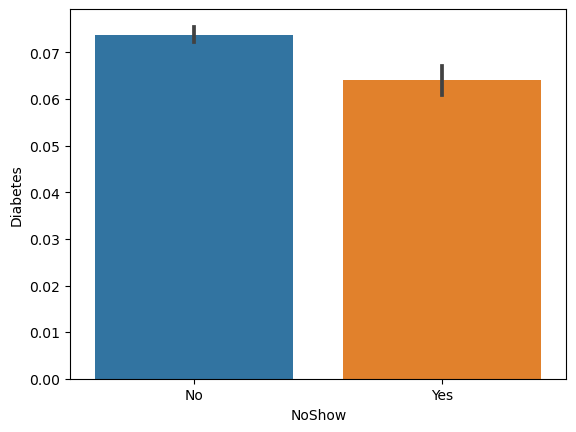

In [52]:
sns.barplot(y='Diabetes',x='NoShow',data=df)

In [53]:
## here inspite of having diabetes the patients didnt attended the appointment('Yes')

<AxesSubplot:xlabel='NoShow', ylabel='Hypertension'>

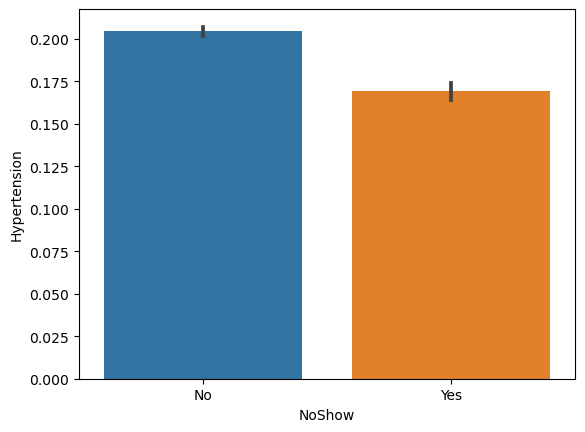

In [54]:
sns.barplot(x='NoShow',y='Hypertension',data=df)

In [55]:
## here patients having hypertension didnt attended the appointment

In [56]:
df.dtypes

Gender                      object
ScheduledDay        datetime64[ns]
AppointmentDay      datetime64[ns]
Age                          int64
Scholarship                  int64
Hypertension                 int64
Diabetes                     int64
Alcoholism                   int64
Handicap                     int64
SMS_received                 int64
NoShow                      object
sch_weekday                  int32
appntmnt_weekday             int32
dtype: object

<AxesSubplot:xlabel='NoShow', ylabel='Alcoholism'>

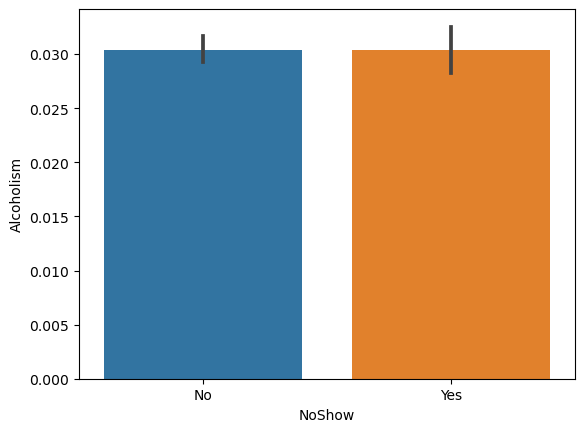

In [57]:
sns.barplot(x='NoShow',y='Alcoholism',data=df)

In [58]:
## here patients with same alcohol consumption rate are equal for both attended appointment and not appointment

<AxesSubplot:xlabel='NoShow', ylabel='Handicap'>

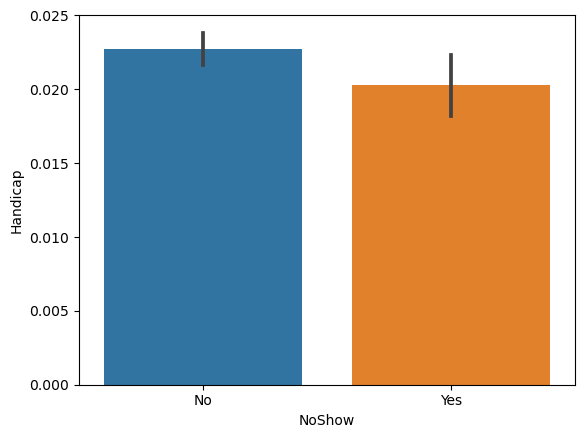

In [59]:
sns.barplot(x='NoShow',y='Handicap',data=df)

In [60]:
## patients with handicap problem didnt showed up for the appointment

<AxesSubplot:xlabel='NoShow', ylabel='SMS_received'>

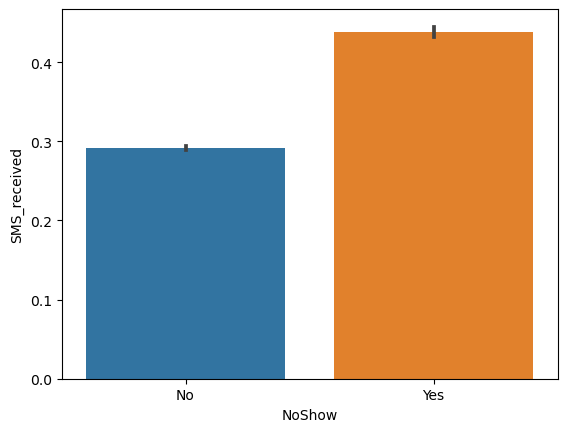

In [61]:
sns.barplot(x='NoShow',y='SMS_received',data=df)

In [62]:
## inspite of receiving the sms reminder from the healthcare provider there are more patients didnt show-up for the appointment

In [63]:
df.dtypes

Gender                      object
ScheduledDay        datetime64[ns]
AppointmentDay      datetime64[ns]
Age                          int64
Scholarship                  int64
Hypertension                 int64
Diabetes                     int64
Alcoholism                   int64
Handicap                     int64
SMS_received                 int64
NoShow                      object
sch_weekday                  int32
appntmnt_weekday             int32
dtype: object

<AxesSubplot:xlabel='NoShow', ylabel='sch_weekday'>

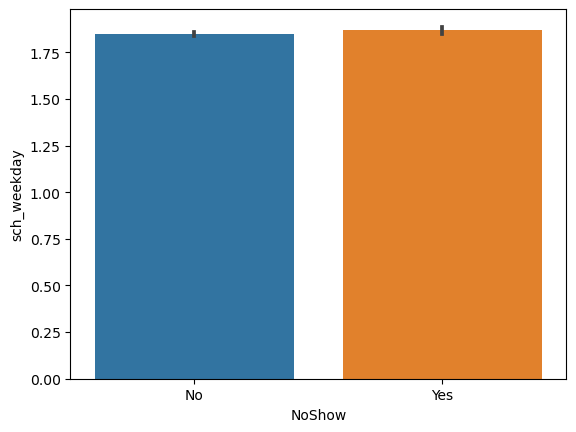

In [64]:
sns.barplot(x='NoShow',y='sch_weekday',data=df)

In [65]:
## patients who attended the appointment and not attended the appointment in weekday is same

<AxesSubplot:xlabel='NoShow', ylabel='appntmnt_weekday'>

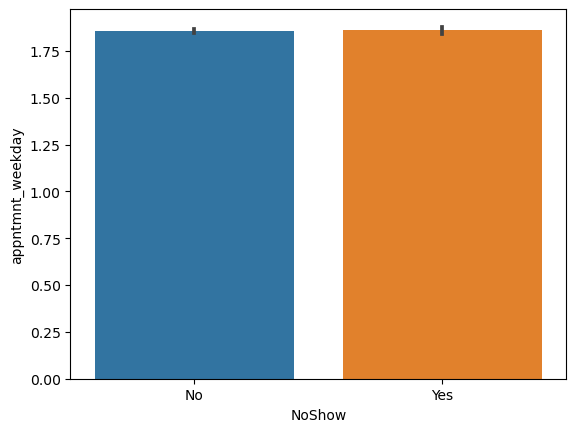

In [66]:
sns.barplot(y='appntmnt_weekday',x='NoShow',data=df)

<AxesSubplot:>

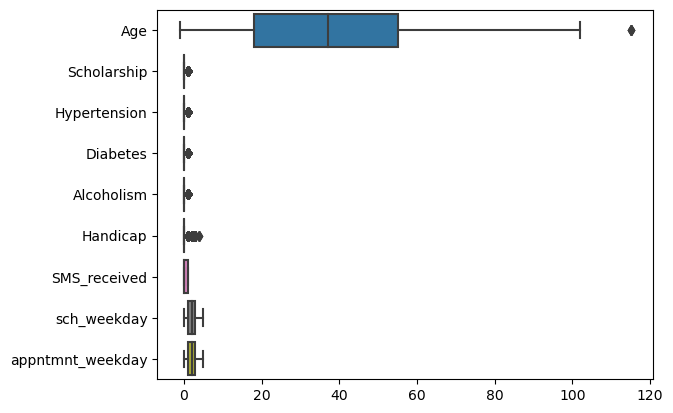

In [67]:
sns.boxplot(data=df,orient='h')

df

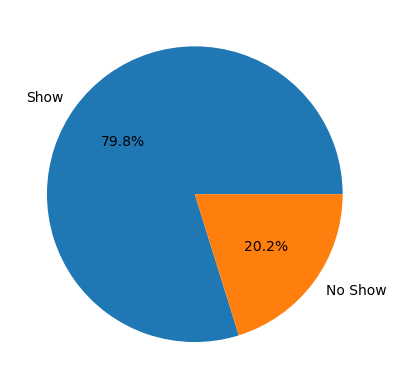

In [68]:
plt.pie(df["NoShow"].value_counts(), labels=["Show", "No Show"], autopct="%.01f%%")
plt.show()

In [69]:
## here there is outlier in 'age' feature 

In [70]:
## here in 'age' feature outlier is '115'

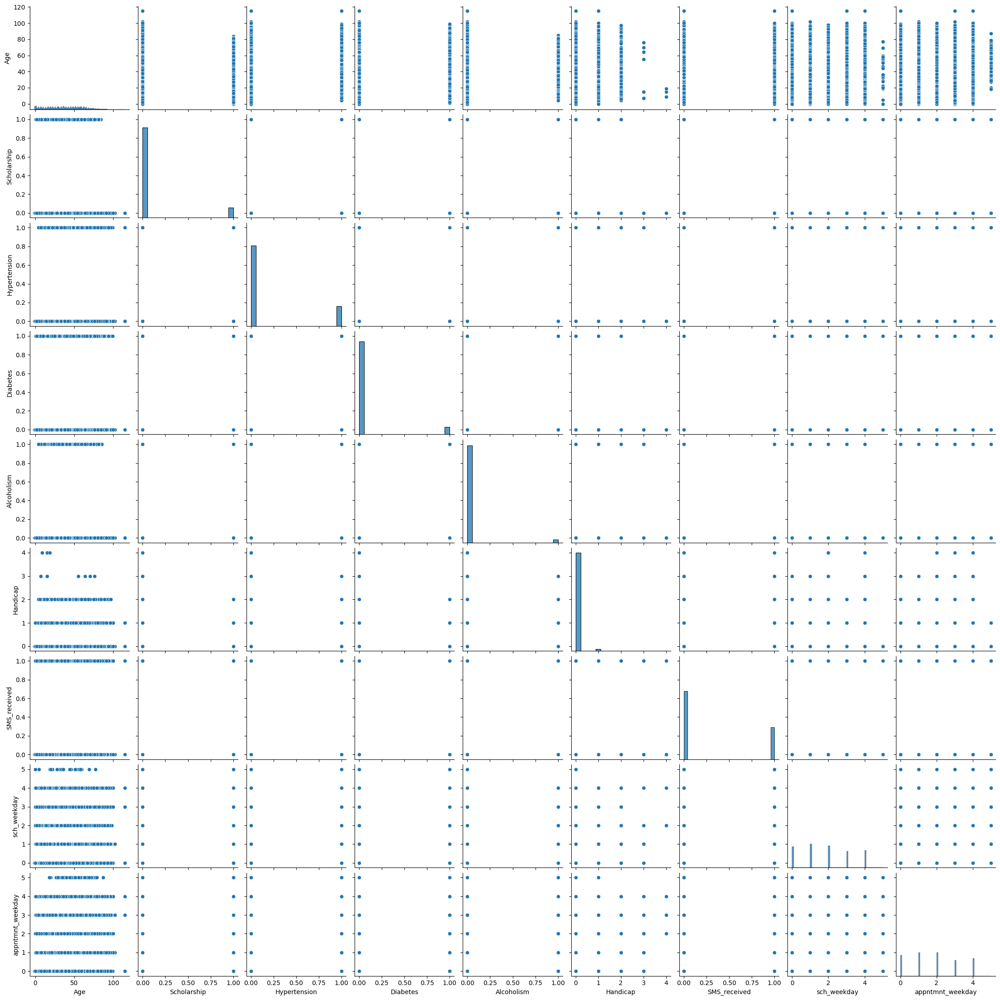

In [71]:
sns.pairplot(df)

In [72]:
df.columns

Index(['Gender', 'ScheduledDay', 'AppointmentDay', 'Age', 'Scholarship',
       'Hypertension', 'Diabetes', 'Alcoholism', 'Handicap', 'SMS_received',
       'NoShow', 'sch_weekday', 'appntmnt_weekday'],
      dtype='object')

In [73]:
df.describe()

,ScheduledDay,AppointmentDay,Age,Scholarship,Hypertension,Diabetes,Alcoholism,Handicap,SMS_received,sch_weekday,appntmnt_weekday
count,110527,110527,110527.000000,110527.000000,110527.000000,110527.000000,110527.000000,110527.000000,110527.000000,110527.000000,110527.000000
mean,2016-05-08 20:33:18.179630080,2016-05-19 00:57:50.008233472,37.088874,0.098266,0.197246,0.071865,0.030400,0.022248,0.321026,1.851955,1.858243
min,2015-11-10 00:00:00,2016-04-29 00:00:00,-1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2016-04-29 00:00:00,2016-05-09 00:00:00,18.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
50%,2016-05-10 00:00:00,2016-05-18 00:00:00,37.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,2.000000
75%,2016-05-20 00:00:00,2016-05-31 00:00:00,55.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,3.000000,3.000000
max,2016-06-08 00:00:00,2016-06-08 00:00:00,115.000000,1.000000,1.000000,1.000000,1.000000,4.000000,1.000000,5.000000,5.000000
std,NaN,NaN,23.110205,0.297675,0.397921,0.258265,0.171686,0.161543,0.466873,1.378520,1.371672


In [74]:
df['ScheduledDay']=pd.to_datetime(df['ScheduledDay'])

In [75]:
df['AppointmentDay']=pd.to_datetime(df['AppointmentDay'])

In [76]:
df['waiting_days']=(df['AppointmentDay']-df['ScheduledDay'])

In [77]:
df['waiting_days']=(df['waiting_days']/np.timedelta64(1,'D')).astype(int)

<AxesSubplot:xlabel='NoShow', ylabel='waiting_days'>

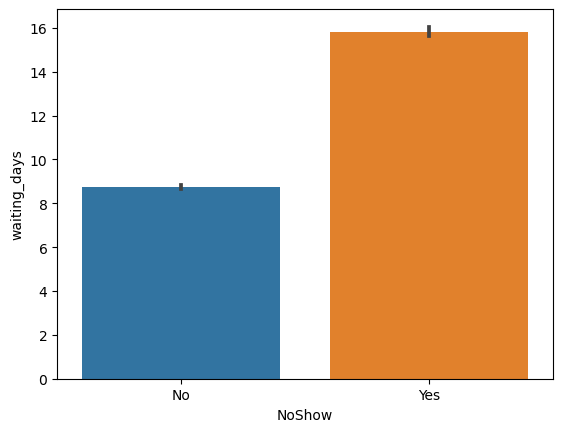

In [78]:
sns.barplot(x='NoShow',y='waiting_days',data=df)

In [79]:
## patients with more no. of waiting days are less likely to showup

In [80]:
## data transformation

In [81]:
df['Age_trnsfrm']=np.sqrt(df['Age'])

C:\ANACONDA\lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [82]:
print(df['Age_trnsfrm'])

0          7.874008
1          7.483315
2          7.874008
3          2.828427
4          7.483315
5          8.717798
6          4.795832
7          6.244998
8          4.582576
9          4.358899
10         5.477226
11         5.385165
12         4.690416
13         5.291503
14         7.348469
15         3.872983
16         7.071068
17         6.324555
18         5.477226
19         6.782330
20         5.477226
21         2.000000
22         3.605551
23         6.782330
24         8.062258
25         6.782330
26         6.708204
27         2.000000
28         7.141428
29         5.656854
30         6.782330
31         3.464102
32         7.810250
33         6.164414
34         8.888194
35         4.242641
36         7.937254
37         8.000000
38         9.219544
39         7.681146
40         7.416198
41         8.426150
42         7.071068
43         7.000000
44         8.831761
45         5.567764
46         7.615773
47         6.244998
48         7.615773
49         5.196152


In [83]:
df['Scholarship_trnsfrm']=np.sqrt(df['Scholarship'])

In [84]:
print(df['Scholarship_trnsfrm'])

0         0.0
1         0.0
2         0.0
3         0.0
4         0.0
5         0.0
6         0.0
7         0.0
8         0.0
9         0.0
10        0.0
11        0.0
12        1.0
13        0.0
14        0.0
15        0.0
16        0.0
17        1.0
18        1.0
19        0.0
20        0.0
21        0.0
22        0.0
23        0.0
24        0.0
25        0.0
26        0.0
27        0.0
28        0.0
29        0.0
30        0.0
31        1.0
32        0.0
33        1.0
34        0.0
35        0.0
36        0.0
37        1.0
38        0.0
39        0.0
40        0.0
41        0.0
42        0.0
43        0.0
44        0.0
45        0.0
46        0.0
47        0.0
48        0.0
49        0.0
50        0.0
51        1.0
52        1.0
53        0.0
54        0.0
55        0.0
56        0.0
57        0.0
58        0.0
59        0.0
60        1.0
61        0.0
62        1.0
63        0.0
64        0.0
65        0.0
66        0.0
67        0.0
68        0.0
69        0.0
70        0.0
71    

In [85]:
df['Apntmt_trnsfrm']=np.sqrt(df['appntmnt_weekday'])

In [86]:
print(df['Apntmt_trnsfrm'])

0         2.000000
1         2.000000
2         2.000000
3         2.000000
4         2.000000
5         2.000000
6         2.000000
7         2.000000
8         2.000000
9         2.000000
10        2.000000
11        2.000000
12        2.000000
13        2.000000
14        2.000000
15        2.000000
16        2.000000
17        2.000000
18        2.000000
19        2.000000
20        2.000000
21        2.000000
22        2.000000
23        2.000000
24        2.000000
25        2.000000
26        2.000000
27        2.000000
28        2.000000
29        2.000000
30        2.000000
31        2.000000
32        2.000000
33        2.000000
34        2.000000
35        2.000000
36        2.000000
37        2.000000
38        2.000000
39        2.000000
40        2.000000
41        2.000000
42        2.000000
43        2.000000
44        2.000000
45        2.000000
46        2.000000
47        2.000000
48        2.000000
49        2.000000
50        2.000000
51        2.000000
52        2.

In [87]:
df['sch_wkdy_trnsfrm']=np.sqrt(df['sch_weekday'])

In [88]:
print(df['sch_wkdy_trnsfrm'])

0         2.000000
1         2.000000
2         2.000000
3         2.000000
4         2.000000
5         1.414214
6         1.414214
7         1.414214
8         2.000000
9         1.414214
10        1.414214
11        1.000000
12        1.732051
13        1.732051
14        1.732051
15        1.000000
16        1.732051
17        1.732051
18        1.000000
19        2.000000
20        1.414214
21        1.414214
22        0.000000
23        1.732051
24        2.000000
25        1.000000
26        2.000000
27        1.414214
28        2.000000
29        2.000000
30        1.414214
31        1.414214
32        2.000000
33        0.000000
34        2.000000
35        2.000000
36        2.000000
37        2.000000
38        1.414214
39        2.000000
40        1.732051
41        1.732051
42        1.732051
43        2.000000
44        1.732051
45        1.732051
46        0.000000
47        1.732051
48        1.000000
49        1.732051
50        1.732051
51        1.732051
52        1.

In [89]:
df['Diabetes_trnsfrm']=np.sqrt(df['Diabetes'])

In [90]:
print(df['Diabetes_trnsfrm'])

0         0.0
1         0.0
2         0.0
3         0.0
4         1.0
5         0.0
6         0.0
7         0.0
8         0.0
9         0.0
10        0.0
11        0.0
12        0.0
13        0.0
14        0.0
15        0.0
16        0.0
17        0.0
18        0.0
19        0.0
20        0.0
21        0.0
22        0.0
23        0.0
24        0.0
25        0.0
26        0.0
27        0.0
28        0.0
29        0.0
30        0.0
31        0.0
32        0.0
33        0.0
34        0.0
35        0.0
36        1.0
37        1.0
38        0.0
39        0.0
40        0.0
41        1.0
42        0.0
43        0.0
44        1.0
45        0.0
46        0.0
47        1.0
48        0.0
49        0.0
50        0.0
51        0.0
52        0.0
53        0.0
54        0.0
55        0.0
56        0.0
57        0.0
58        0.0
59        0.0
60        0.0
61        0.0
62        0.0
63        0.0
64        0.0
65        0.0
66        0.0
67        0.0
68        0.0
69        0.0
70        0.0
71    

In [91]:
df['hypertension_trnsfrm']=np.sqrt(df['Hypertension'])

In [92]:
print(df['hypertension_trnsfrm'])

0         1.0
1         0.0
2         0.0
3         0.0
4         1.0
5         1.0
6         0.0
7         0.0
8         0.0
9         0.0
10        0.0
11        0.0
12        0.0
13        0.0
14        0.0
15        0.0
16        0.0
17        0.0
18        0.0
19        0.0
20        0.0
21        0.0
22        0.0
23        0.0
24        0.0
25        1.0
26        1.0
27        0.0
28        0.0
29        0.0
30        0.0
31        0.0
32        1.0
33        0.0
34        1.0
35        0.0
36        1.0
37        1.0
38        1.0
39        0.0
40        0.0
41        0.0
42        0.0
43        1.0
44        1.0
45        0.0
46        1.0
47        1.0
48        0.0
49        0.0
50        0.0
51        0.0
52        0.0
53        0.0
54        0.0
55        0.0
56        0.0
57        0.0
58        0.0
59        0.0
60        0.0
61        0.0
62        0.0
63        0.0
64        0.0
65        0.0
66        0.0
67        0.0
68        1.0
69        0.0
70        0.0
71    

In [93]:
df['Alcohol_trnsfrm']=np.sqrt(df['Alcoholism'])

In [94]:
print(df['Alcohol_trnsfrm'])

0         0.0
1         0.0
2         0.0
3         0.0
4         0.0
5         0.0
6         0.0
7         0.0
8         0.0
9         0.0
10        0.0
11        0.0
12        0.0
13        0.0
14        0.0
15        0.0
16        0.0
17        0.0
18        0.0
19        0.0
20        0.0
21        0.0
22        0.0
23        0.0
24        0.0
25        0.0
26        0.0
27        0.0
28        0.0
29        0.0
30        0.0
31        0.0
32        0.0
33        0.0
34        0.0
35        0.0
36        0.0
37        0.0
38        0.0
39        0.0
40        0.0
41        0.0
42        0.0
43        0.0
44        0.0
45        0.0
46        1.0
47        0.0
48        0.0
49        0.0
50        0.0
51        0.0
52        0.0
53        0.0
54        0.0
55        0.0
56        0.0
57        0.0
58        0.0
59        0.0
60        0.0
61        0.0
62        0.0
63        0.0
64        0.0
65        0.0
66        0.0
67        0.0
68        0.0
69        0.0
70        0.0
71    

In [95]:
df['Handicap_trnsfrm']=np.sqrt(df['Handicap'])

In [96]:
print(df['Handicap_trnsfrm'])

0         0.000000
1         0.000000
2         0.000000
3         0.000000
4         0.000000
5         0.000000
6         0.000000
7         0.000000
8         0.000000
9         0.000000
10        0.000000
11        0.000000
12        0.000000
13        0.000000
14        0.000000
15        0.000000
16        0.000000
17        0.000000
18        0.000000
19        0.000000
20        0.000000
21        0.000000
22        0.000000
23        0.000000
24        0.000000
25        0.000000
26        0.000000
27        0.000000
28        0.000000
29        0.000000
30        0.000000
31        0.000000
32        0.000000
33        0.000000
34        0.000000
35        0.000000
36        0.000000
37        0.000000
38        0.000000
39        0.000000
40        0.000000
41        0.000000
42        0.000000
43        0.000000
44        0.000000
45        0.000000
46        0.000000
47        0.000000
48        0.000000
49        0.000000
50        0.000000
51        0.000000
52        0.

<AxesSubplot:>

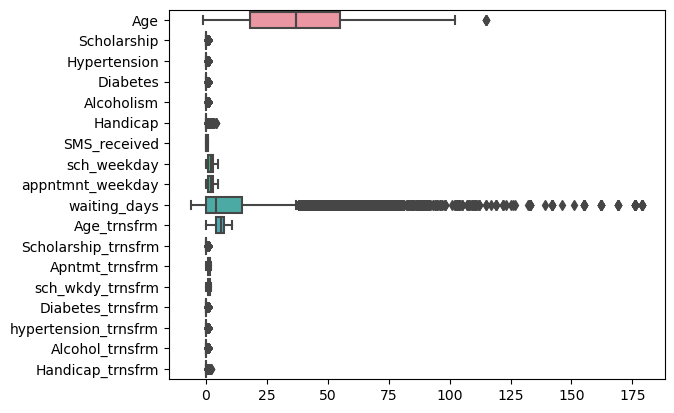

In [97]:
sns.boxplot(data=df,orient='h')

In [98]:
df.drop(['Age','Handicap','Diabetes','Hypertension','Alcoholism','sch_weekday','appntmnt_weekday','Scholarship'],axis=1,inplace=True)

df

In [99]:
df['NoShow'].value_counts()

NoShow
No     88208
Yes    22319
Name: count, dtype: int64

In [100]:
df.dtypes

Gender                          object
ScheduledDay            datetime64[ns]
AppointmentDay          datetime64[ns]
SMS_received                     int64
NoShow                          object
waiting_days                     int32
Age_trnsfrm                    float64
Scholarship_trnsfrm            float64
Apntmt_trnsfrm                 float64
sch_wkdy_trnsfrm               float64
Diabetes_trnsfrm               float64
hypertension_trnsfrm           float64
Alcohol_trnsfrm                float64
Handicap_trnsfrm               float64
dtype: object

In [101]:
from sklearn.preprocessing import LabelEncoder

In [102]:
#create Label Encoder object
le = LabelEncoder()

In [103]:
df['NoShow_encoded']=le.fit_transform(df['NoShow'])

In [104]:
df['Gender_encoded']=le.fit_transform(df['Gender'])

In [105]:
# Calculate the proportion of males and females who attended their appointments
male_data = df[df['Gender_encoded'] == 1]
female_data = df[df['Gender_encoded'] == 0]

male_showup_rate = len(male_data[male_data['NoShow_encoded'] == 1]) / len(male_data)
female_showup_rate = len(female_data[female_data['NoShow_encoded'] == 1]) / len(female_data)

print('Male show-up rate:', male_showup_rate)
print('Female show-up rate:', female_showup_rate)

Male show-up rate: 0.19967947889471915
Female show-up rate: 0.20314587973273943


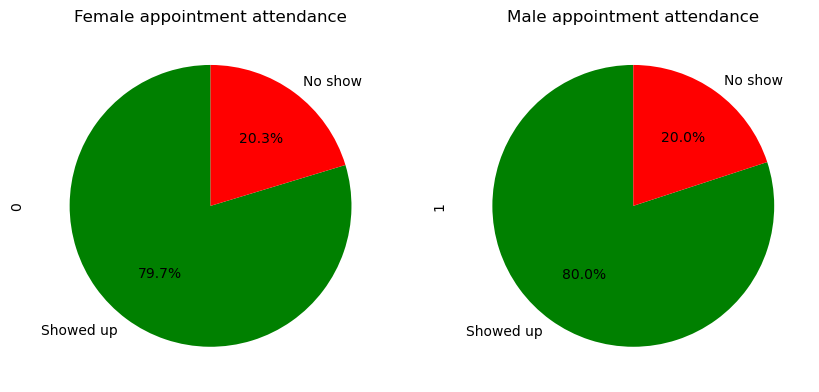

In [106]:
# Group data by gender and attendance
data_grouped = df.groupby(['Gender_encoded', 'NoShow_encoded']).size().unstack()

# Plot pie charts for each gender
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))

data_grouped.loc[0].plot(kind='pie', ax=axes[0], autopct='%1.1f%%', startangle=90, colors=['g', 'r'], labels=['Showed up', 'No show'], legend=False)
data_grouped.loc[1].plot(kind='pie', ax=axes[1], autopct='%1.1f%%', startangle=90, colors=['g', 'r'], labels=['Showed up', 'No show'], legend=False)

axes[0].set(title='Female appointment attendance')
axes[1].set(title='Male appointment attendance')

plt.show()

In [107]:
df.drop(['NoShow','Gender'],axis=1,inplace=True)

<AxesSubplot:>

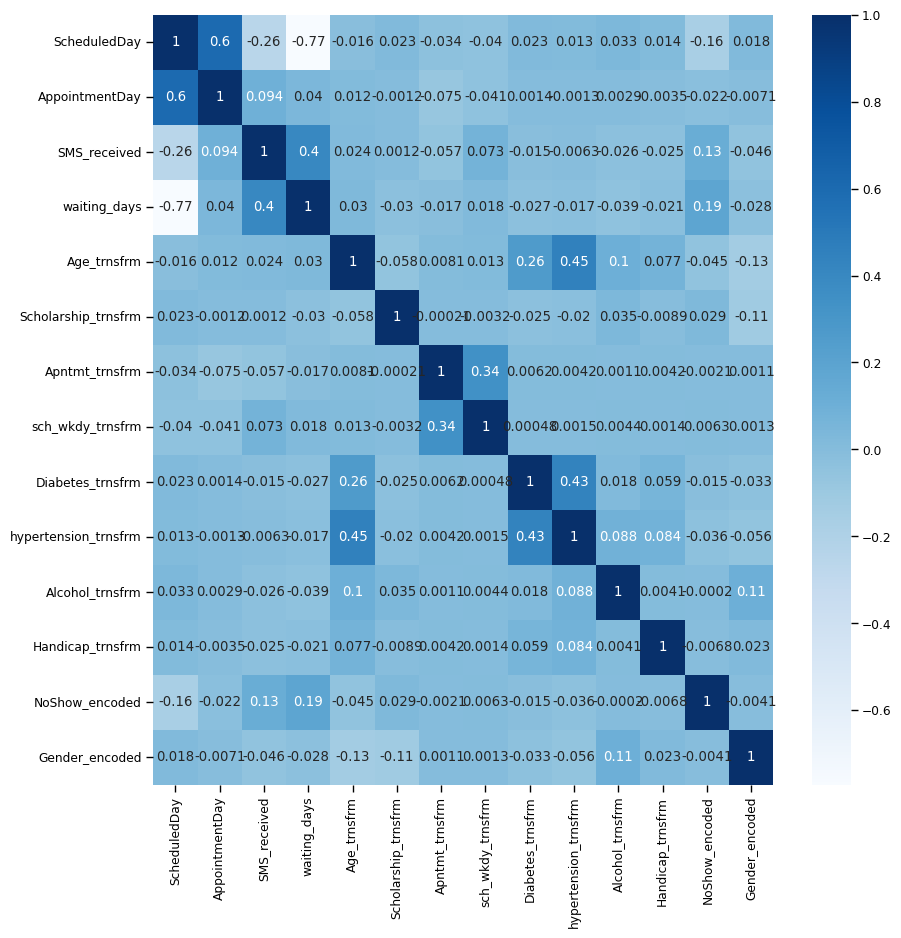

In [108]:
corr=df.corr()
plt.figure(figsize=(10,10))
sns.set_context('paper',font_scale=1)
# Create a heatmap from the correlation matrix
sns.heatmap(corr, annot=True, cmap='Blues')


In [109]:
df.head()

,ScheduledDay,AppointmentDay,SMS_received,waiting_days,Age_trnsfrm,Scholarship_trnsfrm,Apntmt_trnsfrm,sch_wkdy_trnsfrm,Diabetes_trnsfrm,hypertension_trnsfrm,Alcohol_trnsfrm,Handicap_trnsfrm,NoShow_encoded,Gender_encoded
0,2016-04-29,2016-04-29,0,0,7.874008,0.0,2.0,2.0,0.0,1.0,0.0,0.0,0,0
1,2016-04-29,2016-04-29,0,0,7.483315,0.0,2.0,2.0,0.0,0.0,0.0,0.0,0,1
2,2016-04-29,2016-04-29,0,0,7.874008,0.0,2.0,2.0,0.0,0.0,0.0,0.0,0,0
3,2016-04-29,2016-04-29,0,0,2.828427,0.0,2.0,2.0,0.0,0.0,0.0,0.0,0,0
4,2016-04-29,2016-04-29,0,0,7.483315,0.0,2.0,2.0,1.0,1.0,0.0,0.0,0,0


In [110]:
df.describe()

,ScheduledDay,AppointmentDay,SMS_received,waiting_days,Age_trnsfrm,Scholarship_trnsfrm,Apntmt_trnsfrm,sch_wkdy_trnsfrm,Diabetes_trnsfrm,hypertension_trnsfrm,Alcohol_trnsfrm,Handicap_trnsfrm,NoShow_encoded,Gender_encoded
count,110527,110527,110527.000000,110527.000000,110526.000000,110527.000000,110527.000000,110527.000000,110527.000000,110527.000000,110527.000000,110527.000000,110527.000000,110527.000000
mean,2016-05-08 20:33:18.179630080,2016-05-19 00:57:50.008233472,0.321026,10.183702,5.645042,0.098266,1.178168,1.173167,0.071865,0.197246,0.030400,0.021075,0.201933,0.350023
min,2015-11-10 00:00:00,2016-04-29 00:00:00,0.000000,-6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2016-04-29 00:00:00,2016-05-09 00:00:00,0.000000,0.000000,4.242641,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,2016-05-10 00:00:00,2016-05-18 00:00:00,0.000000,4.000000,6.082763,0.000000,1.414214,1.414214,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,2016-05-20 00:00:00,2016-05-31 00:00:00,1.000000,15.000000,7.416198,0.000000,1.732051,1.732051,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
max,2016-06-08 00:00:00,2016-06-08 00:00:00,1.000000,179.000000,10.723805,1.000000,2.236068,2.236068,1.000000,1.000000,1.000000,2.000000,1.000000,1.000000
std,NaN,NaN,0.466873,15.254996,2.285337,0.297675,0.685688,0.689665,0.258265,0.397921,0.171686,0.147662,0.401444,0.476979


In [111]:
df['Age_trnsfrm'].skew()  ## since it is less than 1 we can impute with 'mean'

-0.6605334012260231

In [112]:
df['Age_trnsfrm']=df['Age_trnsfrm'].fillna(df['Age_trnsfrm'].mean())

In [113]:
x=df[['waiting_days','Age_trnsfrm','Scholarship_trnsfrm','SMS_received','sch_wkdy_trnsfrm','Diabetes_trnsfrm','hypertension_trnsfrm','Alcohol_trnsfrm','Handicap_trnsfrm','Gender_encoded']]

In [114]:
y=df['NoShow_encoded']

In [115]:
x.shape

(110527, 10)

In [116]:
y.shape

(110527,)

to handle imbalance class 

In [117]:
from collections import Counter
from imblearn.under_sampling import RandomUnderSampler

In [118]:
# X is your feature matrix and y is your target variable
print("Before undersampling:", Counter(y))

Before undersampling: Counter({0: 88208, 1: 22319})


In [119]:
# Instantiate the RandomUnderSampler class
rus = RandomUnderSampler(random_state=42)

In [120]:
# Fit the undersampler to X and y
X_resampled, y_resampled = rus.fit_resample(x, y)

In [121]:
# Check the class distribution of y after undersampling
print("After undersampling:", Counter(y_resampled))

After undersampling: Counter({0: 22319, 1: 22319})


In [122]:
# Iterate over columns and print unique values
for col in df.columns:
    print(f"Column '{col}' has unique values:")
    print(df[col].unique())
    

Column 'ScheduledDay' has unique values:
<DatetimeArray>
['2016-04-29 00:00:00', '2016-04-27 00:00:00', '2016-04-26 00:00:00',
 '2016-04-28 00:00:00', '2016-04-25 00:00:00', '2016-04-20 00:00:00',
 '2016-03-31 00:00:00', '2016-04-19 00:00:00', '2016-04-06 00:00:00',
 '2016-04-18 00:00:00',
 ...
 '2016-06-03 00:00:00', '2016-06-01 00:00:00', '2016-06-06 00:00:00',
 '2016-06-07 00:00:00', '2016-06-08 00:00:00', '2016-06-04 00:00:00',
 '2016-01-26 00:00:00', '2015-12-07 00:00:00', '2015-12-15 00:00:00',
 '2016-03-05 00:00:00']
Length: 111, dtype: datetime64[ns]
Column 'AppointmentDay' has unique values:
<DatetimeArray>
['2016-04-29 00:00:00', '2016-05-03 00:00:00', '2016-05-10 00:00:00',
 '2016-05-17 00:00:00', '2016-05-24 00:00:00', '2016-05-31 00:00:00',
 '2016-05-02 00:00:00', '2016-05-30 00:00:00', '2016-05-16 00:00:00',
 '2016-05-04 00:00:00', '2016-05-19 00:00:00', '2016-05-12 00:00:00',
 '2016-05-06 00:00:00', '2016-05-20 00:00:00', '2016-05-05 00:00:00',
 '2016-05-13 00:00:00', '2

In [123]:
x=x.astype(float)

In [124]:
df.drop(['ScheduledDay','AppointmentDay'],axis=1,inplace=True)

In [125]:
# replace 0 and 0. values with NaN
df = df.replace([0, 0.0, 0.], np.nan)

# convert all columns to float
df = df.astype(float)

print(df.dtypes)

SMS_received            float64
waiting_days            float64
Age_trnsfrm             float64
Scholarship_trnsfrm     float64
Apntmt_trnsfrm          float64
sch_wkdy_trnsfrm        float64
Diabetes_trnsfrm        float64
hypertension_trnsfrm    float64
Alcohol_trnsfrm         float64
Handicap_trnsfrm        float64
NoShow_encoded          float64
Gender_encoded          float64
dtype: object


In [191]:
x.shape

(110527, 10)

In [258]:
from sklearn.model_selection import train_test_split

# train test split 

x_tr,x_test,y_tr,y_test=train_test_split(X_resampled,y_resampled,test_size=.3,random_state=100)

In [259]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score,classification_report,confusion_matrix

In [260]:
logreg=LogisticRegression(max_iter=60,random_state=25)

In [261]:
logreg.fit(x_tr,y_tr)

C:\ANACONDA\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(max_iter=60, random_state=25)

In [262]:
# Predict probabilities of no-show 
train_proba = logreg.predict_proba(x_tr)[:,1]
test_proba = logreg.predict_proba(x_test)[:,1]

In [263]:
# Set threshold value
threshold = 0.5

In [264]:
# Convert predicted probabilities into binary predictions
train_pred = np.where(train_proba > threshold, 1, 0)
test_pred = np.where(test_proba > threshold, 1, 0)

In [265]:
print(accuracy_score(y_tr,train_pred))
print(classification_report(y_tr,train_pred))
print(confusion_matrix(y_tr,train_pred))

0.6251360174102285
              precision    recall  f1-score   support

           0       0.61      0.69      0.65     15626
           1       0.64      0.56      0.60     15620

    accuracy                           0.63     31246
   macro avg       0.63      0.63      0.62     31246
weighted avg       0.63      0.63      0.62     31246

[[10799  4827]
 [ 6886  8734]]


In [266]:
print(accuracy_score(y_test,test_pred))
print(classification_report(y_test,test_pred))
print(confusion_matrix(y_test,test_pred))

0.6296296296296297
              precision    recall  f1-score   support

           0       0.61      0.70      0.65      6693
           1       0.65      0.56      0.60      6699

    accuracy                           0.63     13392
   macro avg       0.63      0.63      0.63     13392
weighted avg       0.63      0.63      0.63     13392

[[4664 2029]
 [2931 3768]]


In [267]:
from sklearn.ensemble import RandomForestClassifier

In [268]:
random_forest_classifier=RandomForestClassifier(n_estimators=50,max_depth=2,min_samples_split=5,min_samples_leaf=5,random_state=10,bootstrap=True)

In [269]:
random_forest_classifier.fit(x_tr,y_tr)

RandomForestClassifier(max_depth=2, min_samples_leaf=5, min_samples_split=5,
                       n_estimators=50, random_state=10)

In [270]:
# Predict probabilities of no-show 
train_proba1 = random_forest_classifier.predict_proba(x_tr)[:,1]
test_proba1= random_forest_classifier.predict_proba(x_test)[:,1]

In [271]:
# Convert predicted probabilities into binary predictions
train_pred1 = np.where(train_proba1 > threshold, 1, 0)
test_pred1= np.where(test_proba1 > threshold, 1, 0)

In [272]:
print(accuracy_score(y_tr,train_pred1))
print(classification_report(y_tr,train_pred1))
print(confusion_matrix(y_tr,train_pred1))

0.6676374575945722
              precision    recall  f1-score   support

           0       0.84      0.42      0.56     15626
           1       0.61      0.92      0.73     15620

    accuracy                           0.67     31246
   macro avg       0.72      0.67      0.65     31246
weighted avg       0.72      0.67      0.65     31246

[[ 6491  9135]
 [ 1250 14370]]


In [273]:
print(accuracy_score(y_test,test_pred1))
print(classification_report(y_test,test_pred1))
print(confusion_matrix(y_test,test_pred1))

0.6685334528076463
              precision    recall  f1-score   support

           0       0.84      0.42      0.56      6693
           1       0.61      0.92      0.73      6699

    accuracy                           0.67     13392
   macro avg       0.72      0.67      0.65     13392
weighted avg       0.72      0.67      0.65     13392

[[2801 3892]
 [ 547 6152]]


EXTRA TREE CLASSIFIER

In [302]:
from sklearn.ensemble import ExtraTreesClassifier

model=ExtraTreesClassifier(n_estimators=500,max_depth=30,min_samples_split=15,min_samples_leaf=10,random_state=10,bootstrap=True)#n_estimators =no.of tress ,bootstrap=true means from rows,columns are taken as subsets

In [303]:
model.fit(x_tr,y_tr)

ExtraTreesClassifier(bootstrap=True, max_depth=30, min_samples_leaf=10,
                     min_samples_split=15, n_estimators=500, random_state=10)

In [304]:
train_proba2=model.predict_proba(x_tr)[:,1]

In [305]:
test_proba2=model.predict_proba(x_test)[:,1]

In [306]:
# Convert predicted probabilities into binary predictions
train_pred2 = np.where(train_proba2 > threshold, 1, 0)
test_pred2= np.where(test_proba2 > threshold, 1, 0)

In [307]:
print(accuracy_score(y_tr,train_pred2))
print(classification_report(y_tr,train_pred2))
print(confusion_matrix(y_tr,train_pred2))

0.6765666005248672
              precision    recall  f1-score   support

           0       0.71      0.60      0.65     15626
           1       0.65      0.76      0.70     15620

    accuracy                           0.68     31246
   macro avg       0.68      0.68      0.67     31246
weighted avg       0.68      0.68      0.67     31246

[[ 9322  6304]
 [ 3802 11818]]


In [308]:
print(accuracy_score(y_test,test_pred2))
print(classification_report(y_test,test_pred2))
print(confusion_matrix(y_test,test_pred2))

0.6613649940262843
              precision    recall  f1-score   support

           0       0.69      0.58      0.63      6693
           1       0.64      0.74      0.69      6699

    accuracy                           0.66     13392
   macro avg       0.67      0.66      0.66     13392
weighted avg       0.67      0.66      0.66     13392

[[3915 2778]
 [1757 4942]]


GRADIENT BOOSTING CLASSIFIER

In [309]:
from sklearn.ensemble import GradientBoostingClassifier

GradientBoosting_model=GradientBoostingClassifier(n_estimators=500,max_depth=2,min_samples_split=10,min_samples_leaf=10,learning_rate=0.3,random_state=10)


In [310]:
GradientBoosting_model.fit(x_tr,y_tr)

GradientBoostingClassifier(learning_rate=0.3, max_depth=2, min_samples_leaf=10,
                           min_samples_split=10, n_estimators=500,
                           random_state=10)

In [311]:
train_proba3=GradientBoosting_model.predict_proba(x_tr)[:,1]

In [312]:
test_proba3=GradientBoosting_model.predict_proba(x_test)[:,1]

In [313]:
# Convert predicted probabilities into binary predictions
train_pred3 = np.where(train_proba3 > threshold, 1, 0)
test_pred3= np.where(test_proba3 > threshold, 1, 0)

In [314]:
print(accuracy_score(y_tr,train_pred3))
print(classification_report(y_tr,train_pred3))
print(confusion_matrix(y_tr,train_pred3))

0.6834794853741278
              precision    recall  f1-score   support

           0       0.75      0.55      0.63     15626
           1       0.64      0.82      0.72     15620

    accuracy                           0.68     31246
   macro avg       0.70      0.68      0.68     31246
weighted avg       0.70      0.68      0.68     31246

[[ 8557  7069]
 [ 2821 12799]]


In [315]:
print(accuracy_score(y_test,test_pred3))
print(classification_report(y_test,test_pred3))
print(confusion_matrix(y_test,test_pred3))

0.6686827956989247
              precision    recall  f1-score   support

           0       0.73      0.54      0.62      6693
           1       0.63      0.80      0.71      6699

    accuracy                           0.67     13392
   macro avg       0.68      0.67      0.66     13392
weighted avg       0.68      0.67      0.66     13392

[[3601 3092]
 [1345 5354]]


XG Boost classifier

In [316]:
from xgboost import XGBClassifier

XGB_model=XGBClassifier(n_estimators=120,max_depth=6,max_leaves=5,random_state=10)


In [317]:
XGB_model.fit(x_tr,y_tr)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=6, max_leaves=5,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=120, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=10, ...)

In [318]:
train_proba4=XGB_model.predict_proba(x_tr)[:,1]

In [319]:
test_proba4=XGB_model.predict_proba(x_test)[:,1]

In [320]:
# Convert predicted probabilities into binary predictions
train_pred4 = np.where(train_proba4 > threshold, 1, 0)
test_pred4= np.where(test_proba4 > threshold, 1, 0)

In [321]:
print(accuracy_score(y_tr,train_pred4))
print(classification_report(y_tr,train_pred4))
print(confusion_matrix(y_tr,train_pred4))

0.7251488190488382
              precision    recall  f1-score   support

           0       0.79      0.61      0.69     15626
           1       0.68      0.84      0.75     15620

    accuracy                           0.73     31246
   macro avg       0.74      0.73      0.72     31246
weighted avg       0.74      0.73      0.72     31246

[[ 9572  6054]
 [ 2534 13086]]


In [322]:
print(accuracy_score(y_test,test_pred4))
print(classification_report(y_test,test_pred4))
print(confusion_matrix(y_test,test_pred4))

0.6639038231780168
              precision    recall  f1-score   support

           0       0.71      0.55      0.62      6693
           1       0.63      0.78      0.70      6699

    accuracy                           0.66     13392
   macro avg       0.67      0.66      0.66     13392
weighted avg       0.67      0.66      0.66     13392

[[3697 2996]
 [1505 5194]]


Stacking classifier

In [340]:
from sklearn.ensemble import StackingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC

# create the base models
base_models = [('lr', LogisticRegression()),
               ('dt', DecisionTreeClassifier()),
               ('rf', RandomForestClassifier()),
               ('svm', SVC())]

# create the stacking classifier
stack_model = StackingClassifier(estimators=base_models,cv=3,
                                 final_estimator=LogisticRegression())

# fit the stacking classifier on the training data
stack_model.fit(x_tr, y_tr)

# evaluate the model
accuracy = stack_model.score(x_test, y_test)


In [341]:
train_proba6=stack_model.predict_proba(x_tr)[:,1]

In [342]:
test_proba6=stack_model.predict_proba(x_test)[:,1]

In [343]:
# Convert predicted probabilities into binary predictions
train_pred6 = np.where(train_proba6 > threshold, 1, 0)
test_pred6= np.where(test_proba6 > threshold, 1, 0)

In [344]:
print(accuracy_score(y_tr,train_pred6))
print(classification_report(y_tr,train_pred6))
print(confusion_matrix(y_tr,train_pred6))

0.7071945208986751
              precision    recall  f1-score   support

           0       0.77      0.59      0.67     15626
           1       0.67      0.82      0.74     15620

    accuracy                           0.71     31246
   macro avg       0.72      0.71      0.70     31246
weighted avg       0.72      0.71      0.70     31246

[[ 9288  6338]
 [ 2811 12809]]


In [345]:
print(accuracy_score(y_test,test_pred6))
print(classification_report(y_test,test_pred6))
print(confusion_matrix(y_test,test_pred6))

0.6633064516129032
              precision    recall  f1-score   support

           0       0.71      0.54      0.62      6693
           1       0.63      0.78      0.70      6699

    accuracy                           0.66     13392
   macro avg       0.67      0.66      0.66     13392
weighted avg       0.67      0.66      0.66     13392

[[3633 3060]
 [1449 5250]]


In [349]:
results={'models':['logistic Regression','Random Forest Classifier','Extra tree classifier','Gradient boost Classifier','XGB boost classifier'],'training(accuracy)':[62,66,67,68,72],'testing(accuracy)':[63,67,66,67,66]}

In [350]:
results

{'models': ['logistic Regression',
  'Random Forest Classifier',
  'Extra tree classifier',
  'Gradient boost Classifier',
  'XGB boost classifier'],
 'training(accuracy)': [62, 66, 67, 68, 72],
 'testing(accuracy)': [63, 67, 66, 67, 66]}

In [351]:
result_df=pd.DataFrame(results)

In [352]:
result_df

,models,training(accuracy),testing(accuracy)
0,logistic Regression,62,63
1,Random Forest Classifier,66,67
2,Extra tree classifier,67,66
3,Gradient boost Classifier,68,67
4,XGB boost classifier,72,66


In [ ]:
## amongst all models Gradient boost classifier performed well

# CONCLUSION

1) Patients who receive SMS reminders are less likely to show up for their appointments.
2)Gender , Alcoholism is not a significant factor in predicting whether a patient will show up for their appointment.
3) Appointment scheduled by the healthcare provider  on weekday is not a significant factor to predict the output
4) Handicap patients are slightly more likely to show up 
5) Patients with hypertension,diabetes are slightly more likely to show up
6)patients with more no. of waiting days are less likely to showup

The precision score of 80% means that out of all the predicted no-shows, 80% were actually no-shows. The recall score of 99% means that out of all the actual no-shows, 99% were correctly identified by the model. The F1 score of 89% for the training set and 88% for the testing set is a harmonic mean of precision and recall, which gives an overall measure of the model's performance.

this model can help the hospital to prioritize their efforts towards patients who are likely to miss their appointments, thereby reducing the number of missed appointments and improving the overall efficiency of the hospital.